### Standardizing GM and ShareNow datasets

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import geopandas as gpd
from sklearn.cluster import DBSCAN
# from haversine import haversine as hs
import requests
%matplotlib inline
# from pydantic_settings import BaseSettings
#from ydata_profiling import ProfileReport

import sys
import os
sys.path.append('../utils/')
#sys.path.append('..\\utils\\')

from functions import get_zone_info
from functions import haversine_distance as hsd
from functions import main_concurrent

In [2]:
gmkeepcols = [
    'vehicleId',
    'id',
    'LatitudeStart',
    'LongitudeStart',
    'LatitudeEnd',
    'LongitudeEnd',
    'StartTime',
    'EndTime',
    'age',
    'sex',
    'DriveLength',
    'FromZoneID',
    'ToZoneID',
    'Month',
    'Weekday',
    'StartHour',
    'StartTimeUpdated',
    'TotalDurationMin', 
    'TripDistanceKm', 
    'TotalWalkingTimeMin',
    'TotalTransitTimeMin', 
    'Changes', 
    'PickupStationProximity',
    'DropoffStationProximity', 
    'CarDurationMin', 
    'CarDistanceKm' 
]

snrenamecols = {
    "BilID":"vehicleId"
}

gmrenamecols = {
    'id':'PersonID',
    'age':'Age',
    'sex':'Gender',
    'DriveLength':'KmDriven'
}

In [3]:
# Initialize the dataframes for ShareNow (short trips) and GreenMobility
sharenow = pd.read_csv('../data/processed/sn_shtrips_access_complete.csv')
greenmobility = pd.read_csv('../data/processed/gm_accessibility_complete.csv')

# Drop NAN values in both datasets
sharenow.dropna(inplace=True)
greenmobility.dropna(inplace=True)

# Keep the corresponding columns in GreenMobility dataset
greenmobility = greenmobility[gmkeepcols]

# Rename the columns in both datasets accordingly
greenmobility.rename(columns=gmrenamecols, inplace=True)
sharenow.rename(columns=snrenamecols, inplace=True)

sharenow.drop(columns=['ReservationTime','BatteryStart','BatteryEnd'], inplace=True)

In [224]:
# reorder the columns in the GreenMobility dataset
rowcount = greenmobility.shape[0]
loc = greenmobility.columns.get_loc('Month')

for colname in ['TripDurationHours','TripDurationMinutes','AvgSpeed']:
    greenmobility.insert(loc, colname, np.zeros(rowcount), allow_duplicates=False)
    loc = greenmobility.columns.get_loc('Month')

loc = greenmobility.columns.get_loc('StartTimeUpdated')
greenmobility.insert(loc,'HaversineDistance',np.zeros(rowcount), allow_duplicates=False)

In [225]:
greenmobility['HaversineDistance'] = hsd(greenmobility['LatitudeStart'], greenmobility['LongitudeStart'],greenmobility['LatitudeEnd'], greenmobility['LongitudeEnd'])
greenmobility['EndTime'] = pd.to_datetime(greenmobility['EndTime'], errors='coerce')    #   to DateTime
greenmobility['StartTime'] = pd.to_datetime(greenmobility['StartTime'], errors='coerce')    #   to Datetime


# 5. Auxiliary columns
greenmobility['TripDurationHours'] = (greenmobility['EndTime'] - greenmobility['StartTime']).dt.total_seconds()/3600
greenmobility['TripDurationMinutes'] = greenmobility['TripDurationHours']*60  #   trip duration in min
greenmobility['AvgSpeed'] = greenmobility['KmDriven']/greenmobility['TripDurationHours'] #   avg speed

# round up KmDriven for greenmobility
greenmobility['KmDriven'] = greenmobility['KmDriven'].apply(np.ceil)

# 6. Drop the rows where TripDurationMinutes is less than 0
greenmobility = greenmobility[greenmobility['TripDurationMinutes'] >= 0]

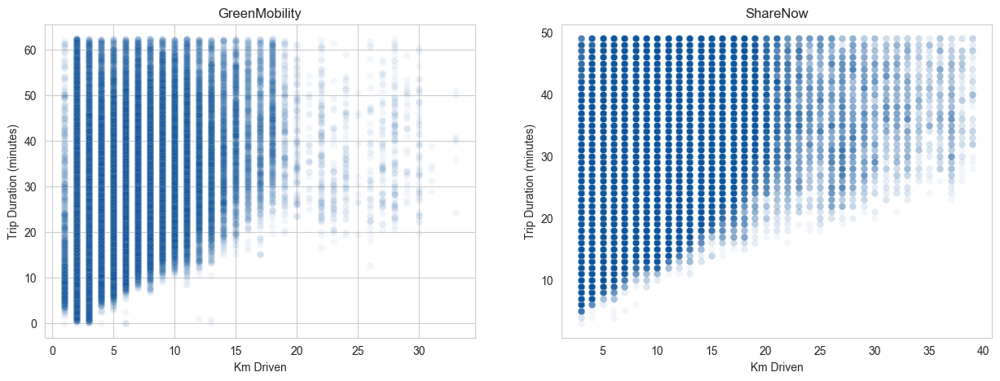

In [199]:
# plot kmdriven against TripDurationMinutes for both datasets in 2 subplots
fig, axes = plt.subplots(1,2, figsize=(15,5))
sns.scatterplot(data=greenmobility[greenmobility['TripDurationMinutes']<greenmobility['TripDurationMinutes'].quantile(0.90)], y='TripDurationMinutes', x='KmDriven', ax=axes[0], alpha=0.05)
axes[0].set_title('GreenMobility')
axes[0].set_xlabel('Km Driven')
axes[0].set_ylabel('Trip Duration (minutes)')

sns.scatterplot(data=sharenow[sharenow['TripDurationMinutes']<sharenow['TripDurationMinutes'].quantile(0.90)], y='TripDurationMinutes', x='KmDriven', ax=axes[1],alpha=0.05)
axes[1].set_title('ShareNow')
axes[1].set_xlabel('Km Driven')
axes[1].set_ylabel('Trip Duration (minutes)')
plt.grid(False)
plt.show()


In [226]:
# concatenate tsn and tgm, and add a column to indicate the source of the data greenmobilty for tgm and sharenow for tsn
greenmobility['source'] = 'greenmobility'
sharenow['source'] = 'sharenow'

# concatenate the two datasets
alltrips = pd.concat([greenmobility,sharenow], axis=0)

# export to csv
alltrips.to_csv('../data/processed/alltrips_before_trimming.csv', index=False)

In [186]:
# plot the distribution of the DriveLength in the Reconciliation dataset using a histogram plot in seaborn
plt.figure(figsize=(10,5))
sns.histplot(reconciliation['DriveLength'], kde=True, bins=30)
sns.set_style('whitegrid')
plt.title('Drive Length Distribution in Reconciliation')
sns.despine()
sns.set_palette('Blues_r')
plt.grid(False)
plt.xlabel('Drive Length (Km)')
plt.ylabel('Frequency')
plt.show()

# reconciliation['DriveLength'].plot(kind='hist', bins=20)

In [42]:
dfplot = greenmobility.groupby('StartHour').size().reset_index(name='Count')
dfplot

,StartHour,Count
0,0,1514
1,1,962
2,2,644
3,3,499
4,4,635
5,5,1202
6,6,2666
7,7,5338
8,8,6018
9,9,5202


In [59]:
# pd.read_csv('../data/raw/GM_preparedData.csv').describe().T

In [267]:
import plotly.graph_objects as go

In [43]:
import plotly.graph_objects as go

r = dfplot['Count'].tolist()
theta = np.arange(0,360,15)
width = [15]*24

ticktexts = [str(i)+":00" if i % 6 == 0 else '' for i in np.arange(24)]

fig = go.Figure(go.Barpolar(
    r=r,
    theta=[i-7.5 for i in theta],
    width=width,
    marker_color=dfplot['Count'],
    marker_colorscale='Blues',
    marker_line_color="white",
    marker_line_width=2,
    opacity=0.9
))

fig.update_layout(
    template=None,
    polar=dict(
        hole=0.4,
        bgcolor='rgb(223, 223,223)',
        radialaxis=dict(
            showticklabels=False,
            ticks='',
            linewidth=2,
            linecolor='white',
            showgrid=False,
        ),
        angularaxis=dict(
            tickvals=[i for i in theta],
            ticktext=ticktexts,
            showline=True,
            direction='clockwise',
            period=24,
            linecolor='white',
            gridcolor='white',
            showticklabels=True,
            ticks=''
        )
    )
)

fig.show()

In [301]:
day = dfplot[(dfplot['StartHour']>6)&(dfplot['StartHour']<19)]
day.shape[0]

12

In [311]:
import plotly.graph_objects as go

r = day['Count'].tolist()
theta = np.arange(0,360,30)
width = [30]*12

ticktexts = [str(i)+":00" if i % 3 == 0 else '' for i in np.arange(13)]

fig = go.Figure(go.Barpolar(
    r=r,
    theta=[i-15 for i in theta],
    width=width,
    marker_color=day['Count'],
    marker_colorscale='Blues',
    marker_line_color="white",
    marker_line_width=2,
    opacity=0.9
))

fig.update_layout(
    template=None,
    polar=dict(
        hole=0.4,
        bgcolor='rgb(223, 223,223)',
        radialaxis=dict(
            showticklabels=False,
            ticks='',
            linewidth=2,
            linecolor='white',
            showgrid=False,
        ),
        angularaxis=dict(
            tickvals=[i for i in theta],
            ticktext=ticktexts,
            showline=True,
            direction='clockwise',
            period=12,
            linecolor='white',
            gridcolor='white',
            showticklabels=True,
            ticks=''
        )
    )
)

fig.show()

In [25]:
# alltrips = pd.read_csv('../data/processed/alltrips.csv')
# box plot on the TripDurationMinutes for the alltrips dataframe
# plt.figure(figsize=(10,5))
# sns.boxplot(data=alltrips, x='source', y='TripDurationMinutes')
# plt.title('Trip Duration in Minutes by Source')
# plt.xlabel('Source')
# plt.ylabel('Trip Duration (minutes)')
# plt.show()

alltrips[alltrips['AvgSpeed']<3].describe()

,PersonID,LatitudeStart,LongitudeStart,LatitudeEnd,LongitudeEnd,Age,KmDriven,FromZoneID,ToZoneID,TripDurationHours,...,HaversineDistance,TotalDurationMin,TripDistanceKm,TotalWalkingTimeMin,TotalTransitTimeMin,Changes,PickupStationProximity,DropoffStationProximity,CarDurationMin,CarDistanceKm
count,3764.000000,3764.000000,3764.000000,3764.000000,3764.000000,3764.000000,3764.000000,3764.000000,3764.000000,3764.000000,...,3764.000000,3764.000000,3764.000000,3764.000000,3764.000000,3764.000000,3764.000000,3764.000000,3764.000000,3764.000000
mean,161186.867694,55.694240,12.552329,55.694271,12.552404,32.069607,2.063231,116027.506908,115784.340595,0.727728,...,0.808121,10.092592,1.191851,8.140551,1.857421,0.010893,439.831575,439.773664,3.121015,1.208275
std,52998.415347,0.029463,0.034600,0.029599,0.034778,11.995346,0.492017,22958.535040,22841.705013,0.196660,...,0.702587,7.324849,1.121523,5.916961,2.855311,0.103812,376.602754,373.769425,2.525729,0.993434
min,123.000000,55.614160,12.440370,55.613980,12.440280,18.000000,1.000000,102110.000000,102110.000000,0.180000,...,0.000626,0.016667,0.000010,0.016667,0.000000,0.000000,0.010000,0.010000,0.016667,0.000010
25%,121544.750000,55.674198,12.530918,55.674510,12.530870,22.000000,2.000000,102420.000000,102420.000000,0.580208,...,0.211204,4.100000,0.302382,3.666667,0.000000,0.000000,151.665000,154.487500,1.033333,0.360007
50%,161413.000000,55.692290,12.552969,55.692290,12.553165,29.000000,2.000000,102630.000000,102610.000000,0.721944,...,0.631823,9.616667,0.818705,7.425000,0.000000,0.000000,356.255000,356.810000,2.766667,1.018940
75%,206633.750000,55.707785,12.576900,55.708040,12.577400,38.000000,2.000000,147110.000000,147110.000000,0.878681,...,1.307262,15.041667,1.945908,11.758333,4.000000,0.000000,646.705000,649.930000,4.733333,1.932053
max,249154.000000,55.788280,12.649840,55.790750,12.677390,90.000000,4.000000,185200.000000,185200.000000,1.283333,...,4.284464,43.416667,7.851340,40.316667,16.000000,1.000000,3067.550000,3067.550000,22.316667,5.319870


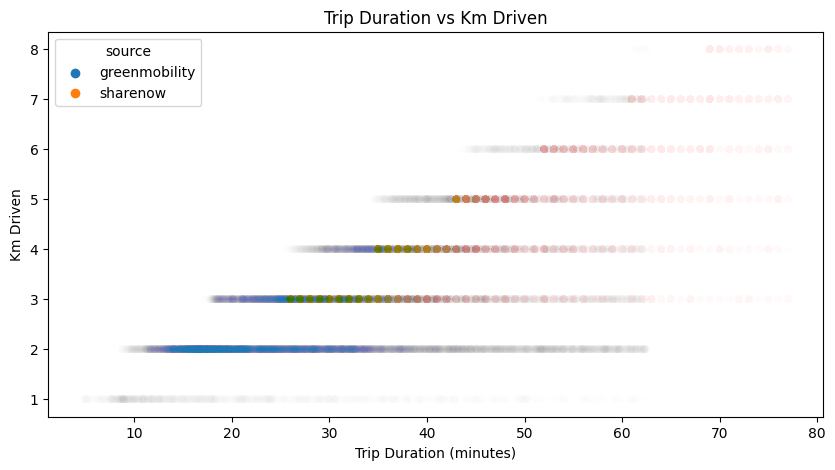

In [40]:
# scatter plot for alltrips[alltrips['AvgSpeed']<7] for the TripDurationMinutes and KmDriven
plt.figure(figsize=(10,5))
sns.scatterplot(data=alltrips[alltrips['AvgSpeed']<7], x='TripDurationMinutes', y='KmDriven', hue='source', alpha=0.005)
plt.title('Trip Duration vs Km Driven')
plt.xlabel('Trip Duration (minutes)')
plt.ylabel('Km Driven')
plt.show()

In [87]:

# scatter plot of kmdriven and trip duration minutes for alltrips using plotly express figsize should be 10,5 and no background and gridlines

fig = px.scatter(alltrips, x='TripDurationMinutes', y='KmDriven', opacity=0.01)
fig.update_layout(width=500, height=500, template=None, font_family='Aptos')
fig.update_yaxes(showgrid=False)
fig.update_xaxes(showgrid=False)
fig.show()




In [60]:
# alltrips.describe().T

### Standardizing GreenMobility and ShareNow datasets

In [126]:
# box plot for the DriveLength in the gm_original dataframe using plotly express
fig = px.box(sharenow, y='KmDriven', points='suspectedoutliers')
fig.update_layout(width=500, height=1000, template=None, font_family='Aptos', title='Drive Length Distribution in GreenMobility')
fig.update_yaxes(showgrid=False)
fig.update_xaxes(showgrid=False)
fig.show()



# plt.figure(figsize=(10,5))
# sns.boxplot(data=gm_original, y='DriveLength')
# sns.set_style('whitegrid')
# sns.despine()
# plt.title('Drive Length Distribution in GreenMobility')
# plt.ylabel('Drive Length (Km)')
# plt.show()



In [114]:
# gm_original[gm_original['CarGenCost']>gm_original['CarGenCost'].quantile(0.75)][['CarGenCost','DriveLength']].describe()
# scatter plot for the DriveLength and CarGenCost in the gm_original dataframe using plotly express
fig = px.scatter(gm_original, x='DriveLength', y='CarGenCost', opacity=0.005)
fig.update_layout(width=500, height=500, template=None, font_family='Aptos', title='Drive Length vs Car Generation Cost in GreenMobility')
fig.update_yaxes(showgrid=False)
fig.update_xaxes(showgrid=False)
fig.show()

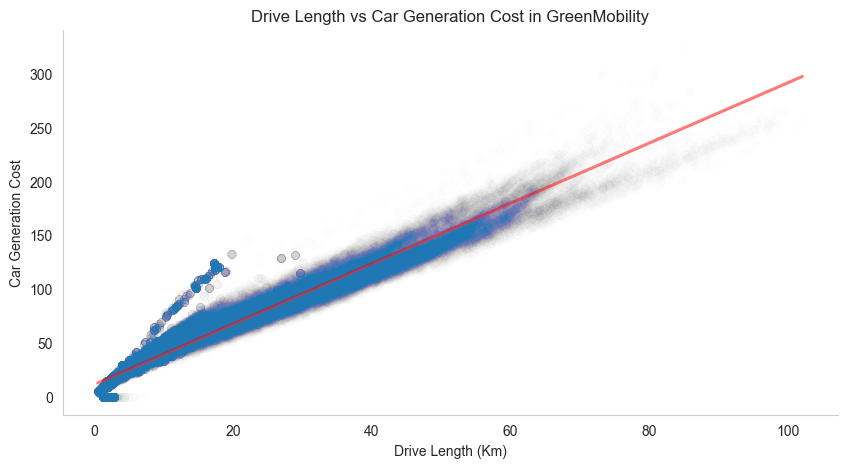

In [116]:
# linear regression plot for the DriveLength and CarGenCost in the gm_original dataframe using seaborn
plt.figure(figsize=(10,5))
sns.regplot(data=gm_original, x='DriveLength', y='CarGenCost', scatter_kws={'alpha':0.005}, line_kws={'color':'r','alpha':0.5})
sns.set_style('whitegrid')
sns.despine()
plt.title('Drive Length vs Car Generation Cost in GreenMobility')
plt.xlabel('Drive Length (Km)')
plt.ylabel('Car Generation Cost')
plt.grid(False)
plt.show()


In [143]:
# alltrips = pd.read_csv('../data/processed/alltrips.csv')
alltrips.head().T

,0,1,2,3,4
vehicleId,206.0,30.0,17.0,144.0,48.0
PersonID,95281.0,103791.0,103996.0,166029.0,172263.0
LatitudeStart,55.67511,55.67554,55.67901,55.68043,55.67881
LongitudeStart,12.58435,12.58329,12.5815,12.58109,12.58385
LatitudeEnd,55.67533,55.67537,55.67537,55.67414,55.67535
LongitudeEnd,12.58326,12.5832,12.58327,12.57805,12.58327
StartTime,2017-07-10 08:43:57,2017-07-16 08:13:52,2017-07-16 11:56:26,2017-08-23 14:59:25,2017-08-26 17:58:05
EndTime,2017-07-10 08:49:17,2017-07-16 08:35:48,2017-07-16 12:03:38,2017-08-23 15:28:24,2017-08-26 18:07:59
Age,22.0,21.0,21.0,21.0,34.0
Gender,M,M,M,M,M


In [131]:
# alltripbefore = pd.read_csv('../data/processed/alltrips_before_trimming.csv')
sharenow['KmDriven'].describe()

count    309676.000000
mean          8.350505
std           5.918387
min           3.000000
25%           4.000000
50%           6.000000
75%          10.000000
max          39.000000
Name: KmDriven, dtype: float64

In [145]:
alltrips.describe().T

,count,mean,std,min,25%,50%,75%,max
PersonID,392275.0,64769.549492,62505.311650,2.000000,26594.000000,42150.000000,57101.000000,249232.000000
LatitudeStart,392275.0,55.686181,0.033978,55.533044,55.665227,55.682407,55.704625,55.938763
LongitudeStart,392275.0,12.557077,0.045054,12.078253,12.531631,12.559765,12.584456,12.679269
LatitudeEnd,392275.0,55.686362,0.034116,55.567490,55.665337,55.682466,55.704768,55.938763
LongitudeEnd,392275.0,12.556784,0.044920,12.078253,12.531255,12.559250,12.584164,12.680980
Age,392275.0,32.552077,10.088732,18.000000,25.000000,30.000000,39.000000,93.000000
KmDriven,392275.0,7.393173,5.003489,1.000000,4.000000,6.000000,9.000000,39.000000
FromZoneID,392275.0,117580.199059,26179.620433,0.000000,102430.000000,102812.000000,147120.000000,269014.000000
ToZoneID,392275.0,117544.352105,26096.180941,0.000000,102430.000000,102812.000000,147114.000000,265242.000000
TripDurationHours,392275.0,0.454440,0.210804,0.050000,0.300000,0.416667,0.566667,1.283333
